In [9]:
from PIL import Image

In [1]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.color import rgb2gray
from sklearn.decomposition import PCA
from skfuzzy.cluster import cmeans
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.cluster import MiniBatchKMeans
from sklearn.cluster import OPTICS
from sklearn.cluster import MeanShift
from sklearn.cluster import Birch
from sklearn.cluster import SpectralClustering
from sklearn.cluster import AffinityPropagation
from sklearn.cluster import AgglomerativeClustering
import tkinter as tk
from tkinter import filedialog
from skimage import io

/home/issa-sangare/.local/lib/python3.10/site-packages/matplotlib/projections/__init__.py:63: UserWarning: Unable to import Axes3D. This may be due to multiple versions of Matplotlib being installed (e.g. as a system package and as a pip package). As a result, the 3D projection is not available.
  warnings.warn("Unable to import Axes3D. This may be due to multiple versions of "


In [2]:
num_colors = 16
num_rows = 2

In [11]:
root = tk.Tk()
root.withdraw() 
path = filedialog.askopenfilename(title='Saisir un fichier')
if path:
    print("Fichier sélectionné:", path)
else:
    print("Aucun fichier choisi. Arrêt du programme.")
root.destroy()

Fichier sélectionné: /home/issa-sangare/Documents/TDM/Image_Compression/3.jpeg


In [4]:
def MSE(image_d_origine, image_traitee):
    # Get the dimensions of the images
    L, C = image_d_origine.shape[:2]  # Assuming it's a 2D image, getting rows and columns
    image_traitee = image_traitee.reshape(image_d_origine.shape)
    # Convert the images to NumPy arrays
    origine = np.array(image_d_origine)
    traitee = np.array(image_traitee)

    # Calculate the sum of squared differences
    somme_differences_carrees = np.sum((origine - traitee) ** 2)

    # Calculate (1 / (L * C)) * somme
    resultat = (1 / (L * C)) * somme_differences_carrees

    return resultat

In [5]:
def display_image_with_palette(image, color_palette, palette_indices, num_rows):
    num_colors = len(color_palette)
    num_cols = num_colors // num_rows

    image_with_palette = color_palette[palette_indices]

    plt.figure(figsize=(30, 15))
    for i, color in enumerate(color_palette):
        plt.subplot(num_rows, num_cols, i + 1)
        color_patch = np.zeros((100, 100, 3), dtype=np.uint8)
        color_patch[:, :] = color
        plt.imshow(color_patch)
        plt.title(f'Couleur {i+1}')
        plt.axis('off')
    plt.suptitle('Palette de couleurs', fontsize=16)
    plt.tight_layout()
    plt.show()

    fig, axs = plt.subplots(1, 2, figsize=(30, 15))
    fig.subplots_adjust(wspace=0.01)

    axs[0].imshow(image)
    axs[0].set_title('Image originale')
    axs[0].axis('off')

    axs[1].imshow(image_with_palette)
    axs[1].set_title(f'Image avec la palette de {num_colors} couleurs')
    axs[1].axis('off')

    fig.tight_layout()

    plt.show()

In [6]:
def plot_images(reconstructed_image, image1, num_colors):
    fig, axs = plt.subplots(1, 2, figsize=(30, 15))
    fig.subplots_adjust(wspace=0.01)

    axs[0].imshow(reconstructed_image)
    axs[0].set_title('Image reconstruite')
    axs[0].axis('off')

    axs[1].imshow(image1)
    axs[1].set_title(f'Image avec la palette de {num_colors} couleurs (median-cut)')
    axs[1].axis('off')

    fig.tight_layout()

    plt.show()

/home/issa-sangare/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


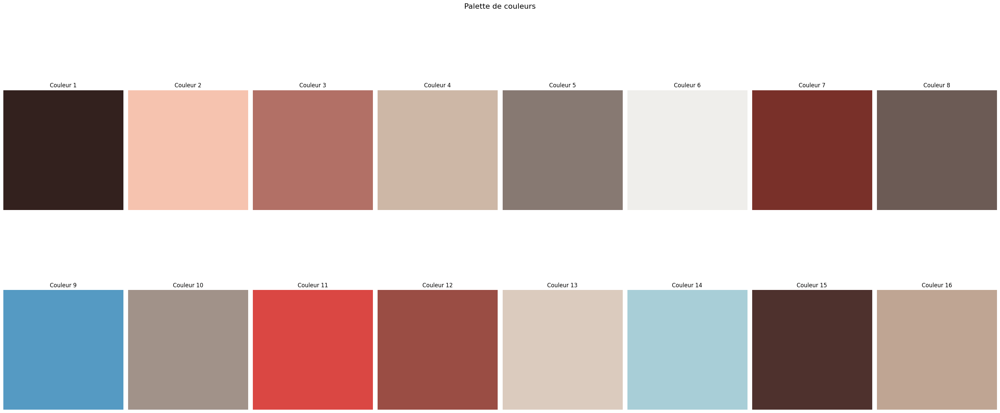

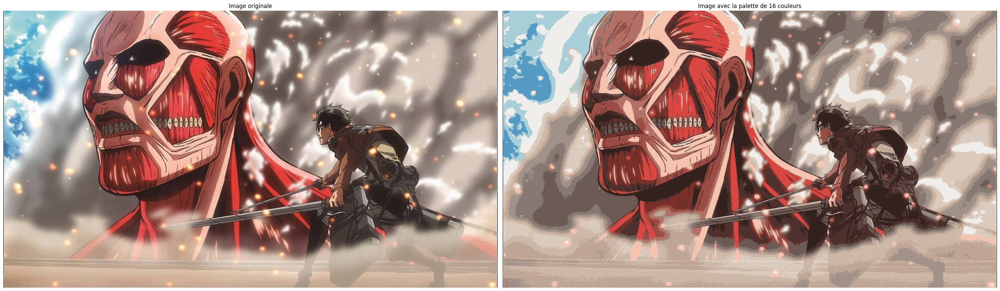

L'erreur quadratique moyenne (MSE) 1 est: 180.35172630257375


In [7]:
def kmeans_clustering_palette(image, num_colors):
    # Convertir l'image en un tableau 2D de pixels
    pixels = np.reshape(image, (-1, 3))

    # Appliquer l'algorithme de K-means pour obtenir les clusters de couleurs
    kmeans = KMeans(n_clusters=num_colors)
    kmeans.fit(pixels)
    color_palette = kmeans.cluster_centers_.astype(np.uint8)

    # Calculer les indices des couleurs dans la palette pour chaque pixel de l'image
    palette_indices = kmeans.predict(pixels)
    palette_indices = np.reshape(palette_indices, np.array(image).shape[:2])

    return color_palette, palette_indices

# Exemple d'utilisation
# Remplacez 'votre_image.jpg' par le chemin vers votre image
image = plt.imread(path)
color_palette, palette_indices = kmeans_clustering_palette(image, num_colors)
display_image_with_palette(image, color_palette, palette_indices, num_rows)
# Example usage with two matrices (reconstructed_image and image)
erreur1 = MSE(image, color_palette[palette_indices])
print(f"L'erreur quadratique moyenne (MSE) 1 est: {erreur1}")

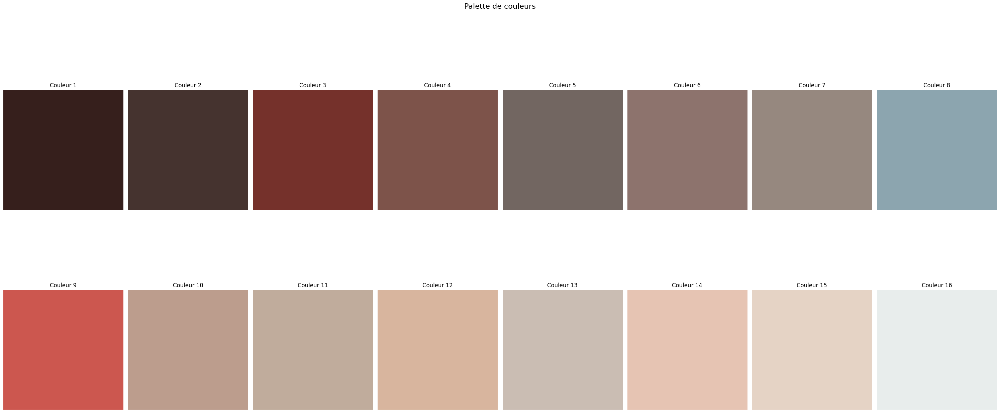

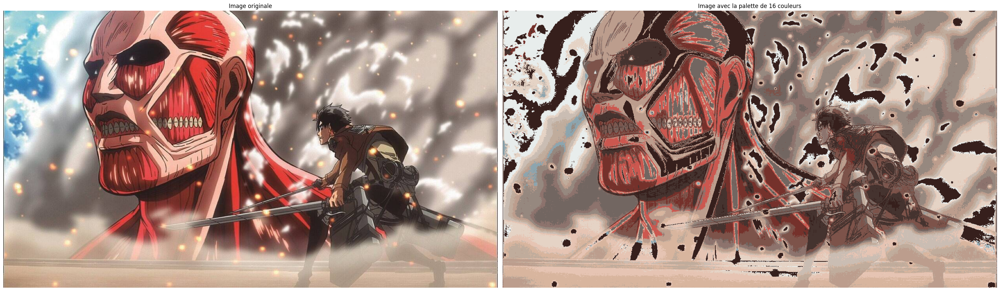

L'erreur quadratique moyenne (MSE) 1 est: 287.4351750964039


In [8]:
def median_cut_palette(image, num_colors):
    # Convertir l'image en un tableau 2D de pixels
    pixels = np.reshape(image, (-1, 3))

    # Initialiser la liste des cubes de couleur avec le cube contenant tous les pixels
    cubes = [pixels]

    # Répéter jusqu'à ce que le nombre de cubes atteigne le nombre de couleurs souhaité
    while len(cubes) < num_colors:
        # Sélectionner le cube le plus grand
        largest_cube_index = np.argmax([cube.shape[0] for cube in cubes])
        largest_cube = cubes.pop(largest_cube_index)

        # Trouver l'axe dominant pour diviser le cube
        axis = np.argmax(np.max(largest_cube, axis=0) - np.min(largest_cube, axis=0))

        # Trier les pixels du cube le long de l'axe dominant
        sorted_cube = largest_cube[largest_cube[:, axis].argsort()]

        # Diviser le cube en deux parties égales
        split_index = len(sorted_cube) // 2
        cube1 = sorted_cube[:split_index]
        cube2 = sorted_cube[split_index:]

        # Ajouter les deux nouveaux cubes à la liste
        cubes.append(cube1)
        cubes.append(cube2)

    # Calculer les couleurs moyennes pour chaque cube
    color_palette = [np.mean(cube, axis=0) for cube in cubes]
    color_palette = np.array(color_palette).astype(np.uint8)

    # Calculer les indices des couleurs dans la palette pour chaque pixel de l'image
    palette_indices = np.zeros(len(pixels), dtype=int)
    for i, pixel in enumerate(pixels):
        distances = np.linalg.norm(color_palette - pixel, axis=1)
        palette_indices[i] = np.argmin(distances)

    palette_indices = np.reshape(palette_indices, np.array(image).shape[:2])

    return color_palette, palette_indices

# Exemple d'utilisation
# Remplacez 'votre_image.jpg' par le chemin vers votre image
image = plt.imread(path)
color_palette, palette_indices = median_cut_palette(image, num_colors)
display_image_with_palette(image, color_palette, palette_indices, num_rows)
# Example usage with two matrices (reconstructed_image and image)
erreur1 = MSE(image, color_palette[palette_indices])
print(f"L'erreur quadratique moyenne (MSE) 1 est: {erreur1}")

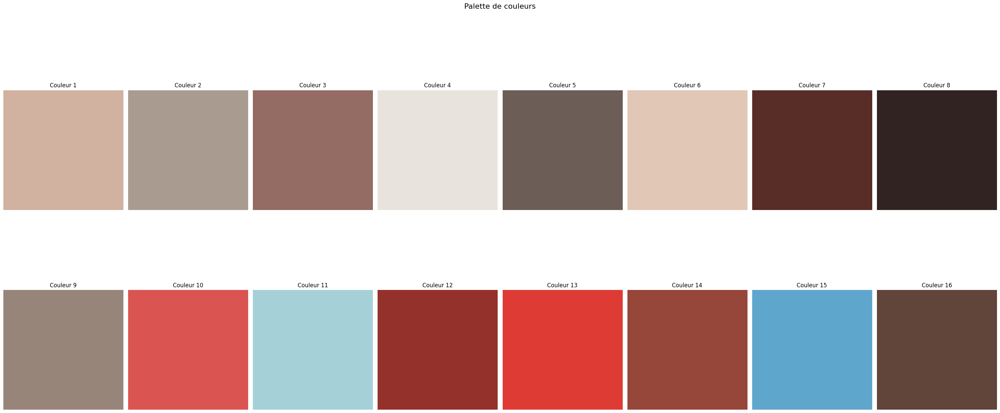

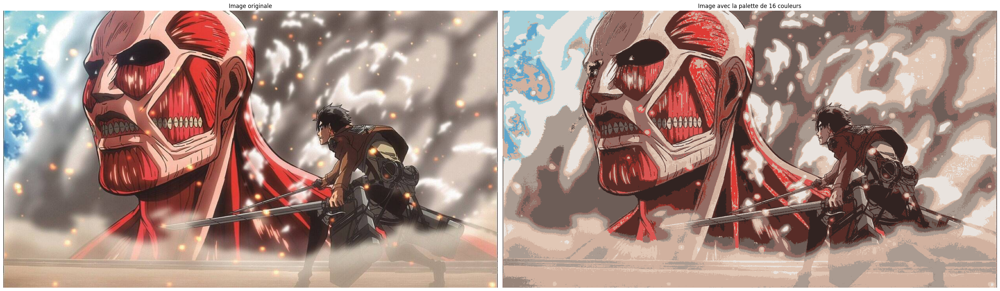

L'erreur quadratique moyenne (MSE) 1 est: 903.2024044928705


In [12]:
def octree_palette(image, num_colors):
    if isinstance(image, np.ndarray):
        image = Image.fromarray(image)
        
    img_rgb = image.convert("RGB")
    img_with_palette = img_rgb.quantize(colors=num_colors, method=Image.FASTOCTREE)
    palette = img_with_palette.getpalette()[:num_colors * 3]
    palette = np.array(palette).reshape(-1, 3)
    indices = np.array(img_with_palette)

    # Retourner la palette de couleurs et leurs indices
    return palette, indices

# Exemple d'utilisation
# Remplacez 'votre_image.jpg' par le chemin vers votre image
image = plt.imread(path)
color_palette, palette_indices = octree_palette(image, num_colors)
display_image_with_palette(image, color_palette, palette_indices, num_rows)
# Example usage with two matrices (reconstructed_image and image)
erreur1 = MSE(image, color_palette[palette_indices])
print(f"L'erreur quadratique moyenne (MSE) 1 est: {erreur1}")

/home/issa-sangare/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


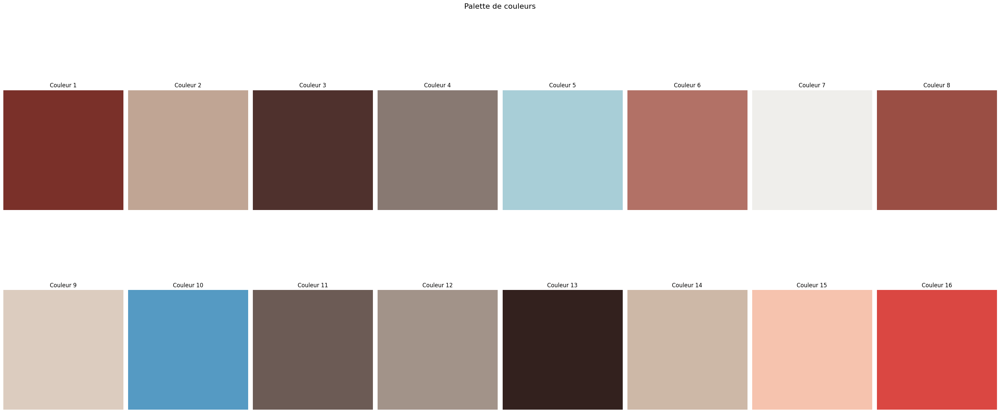

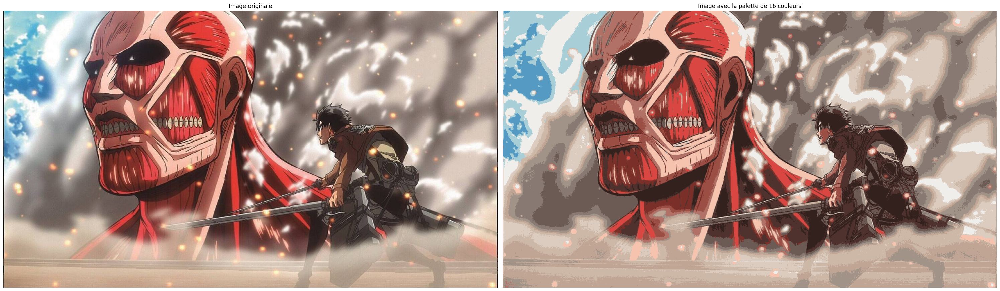

L'erreur quadratique moyenne (MSE) 1 est: 181.40705990494124


In [ ]:
def perceptual_color_palette(image, num_colors):
    flattened_image = image.reshape(-1, 3)
    kmeans = KMeans(n_clusters=num_colors, random_state=42)
    kmeans.fit(flattened_image)
    palette = kmeans.cluster_centers_.astype(np.uint8)
    palette_indices = kmeans.labels_.reshape(image.shape[:2])
    return palette, palette_indices

# Exemple d'utilisation
# Remplacez 'votre_image.jpg' par le chemin vers votre image
image = plt.imread(path)
color_palette, palette_indices = perceptual_color_palette(image, num_colors)
display_image_with_palette(image, color_palette, palette_indices, num_rows)
# Example usage with two matrices (reconstructed_image and image)
erreur1 = MSE(image, color_palette[palette_indices])
print(f"L'erreur quadratique moyenne (MSE) 1 est: {erreur1}")

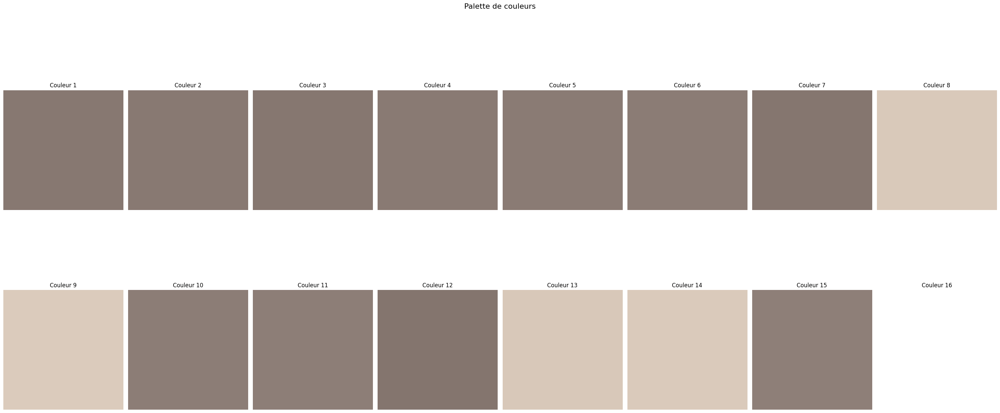

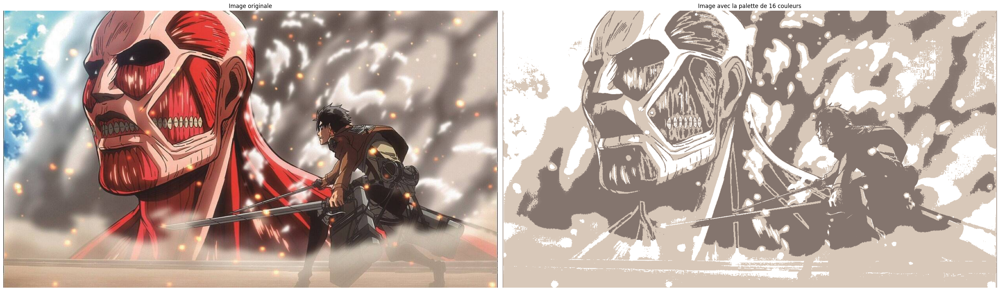

L'erreur quadratique moyenne (MSE) 1 est: 299.6008149493319


In [11]:
def histogram_based_palette(image, num_colors):
    histogram, _ = np.histogramdd(image.reshape(-1, 3), bins=(256, 256, 256))
    colors_indices = np.argsort(histogram.flatten())[::-1][:num_colors]
    palette = np.unravel_index(colors_indices, (256, 256, 256))
    palette = np.array(palette).T.astype(np.uint8)
    palette_indices = np.argmin(np.linalg.norm(palette[:, np.newaxis, np.newaxis, :] - image, axis=-1), axis=0)
    return palette, palette_indices

# Exemple d'utilisation
# Remplacez 'votre_image.jpg' par le chemin vers votre image
image = plt.imread(path)
color_palette, palette_indices = histogram_based_palette(image, num_colors)
display_image_with_palette(image, color_palette, palette_indices, num_rows)
# Example usage with two matrices (reconstructed_image and image)
erreur1 = MSE(image, color_palette[palette_indices])
print(f"L'erreur quadratique moyenne (MSE) 1 est: {erreur1}")

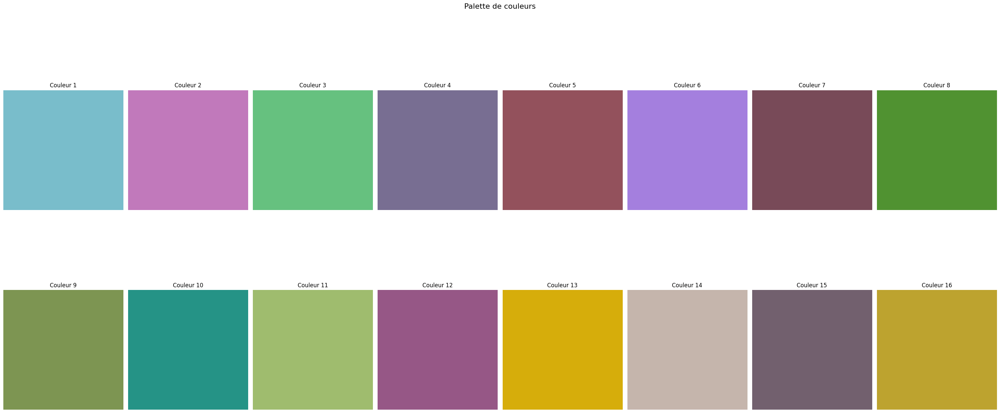

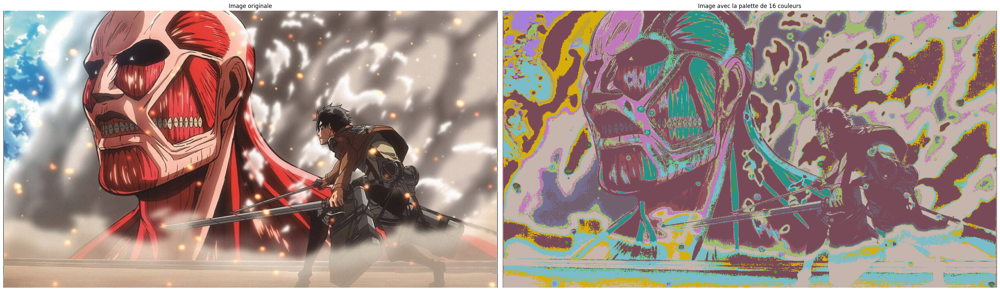

L'erreur quadratique moyenne (MSE) 1 est: 299.0862344184378


In [12]:
def generative_color_palette(image, num_colors):
    # Charger l'image
    image = np.array(image)
    
    # Générer la palette de couleurs
    palette = np.random.normal(loc=128, scale=50, size=(num_colors, 3))
    palette = np.clip(palette, 0, 255).astype(np.uint8)
    
    # Calculer la distance entre chaque pixel de l'image et chaque couleur de la palette
    distances = np.linalg.norm(palette[:, np.newaxis, np.newaxis, :] - image, axis=-1)
    
    # Sélectionner l'indice de la couleur la plus proche pour chaque pixel
    closest_color_indices = np.argmin(distances, axis=0)
    
    return palette, closest_color_indices

# Exemple d'utilisation
# Remplacez 'votre_image.jpg' par le chemin vers votre image
image = plt.imread(path)
color_palette, palette_indices = generative_color_palette(image, num_colors)
display_image_with_palette(image, color_palette, palette_indices, num_rows)
# Example usage with two matrices (reconstructed_image and image)
erreur1 = MSE(image, color_palette[palette_indices])
print(f"L'erreur quadratique moyenne (MSE) 1 est: {erreur1}")

In [ ]:
def pca_color_palette(image, num_colors):
    flattened_image = image.reshape(-1, 3)
    pca = PCA(n_components=3)
    pca.fit(flattened_image)
    transformed_colors = pca.transform(flattened_image)
    kmeans = KMeans(n_clusters=num_colors, random_state=42)
    kmeans.fit(transformed_colors)
    palette = pca.inverse_transform(kmeans.cluster_centers_).astype(np.uint8)
    palette_indices = kmeans.predict(transformed_colors).reshape(image.shape[:2])
    return palette, palette_indices

# Exemple d'utilisation
# Remplacez 'votre_image.jpg' par le chemin vers votre image
image = plt.imread(path)
color_palette, palette_indices = pca_color_palette(image, num_colors)
display_image_with_palette(image, color_palette, palette_indices, num_rows)
# Example usage with two matrices (reconstructed_image and image)
erreur1 = MSE(image, color_palette[palette_indices])
print(f"L'erreur quadratique moyenne (MSE) 1 est: {erreur1}")